# Data visualization

In [1]:
# https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

In [5]:
import os
import sys
from glob import glob
from datetime import datetime
import warnings
warnings.filterwarnings("ignore")

import shutil

# Project
project_common_path = os.path.dirname('.')
project_common_path = os.path.abspath(os.path.join(project_common_path, '..'))
if not project_common_path in sys.path:
    sys.path.append(project_common_path)

In [6]:
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
%matplotlib inline

In [7]:
from common.data_utils import train_ids, METADATA_CSV, TRAIN_MASKS_CSV
from common.image_utils import get_image_data

Image shape: (1280, 1918, 3) | image type: uint8 | mask shape: (1280, 1918) | mask type: uint8


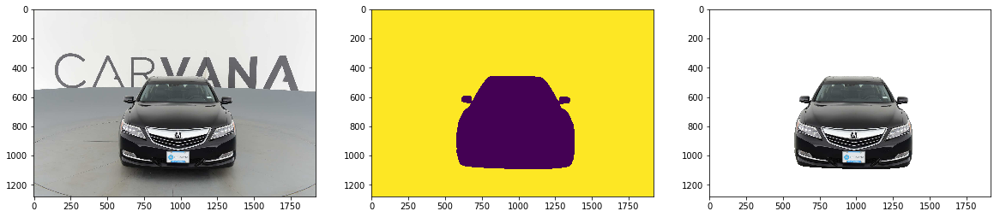

In [8]:
import cv2

image_id = train_ids[0]

plt.figure(figsize=(20, 20))
img = get_image_data(image_id, "Train")
mask = get_image_data(image_id, "Train_mask")
unmask = (~mask / 255).astype(np.uint8)
white_bg = 255 * np.ones_like(img, dtype=np.uint8)
img_masked = cv2.bitwise_and(img, img, mask=mask) 
white_bg = cv2.bitwise_and(white_bg, white_bg, mask=unmask) 
img_masked = img_masked + white_bg

print("Image shape: {} | image type: {} | mask shape: {} | mask type: {}".format(img.shape, img.dtype, mask.shape, mask.dtype) )

plt.subplot(131)
plt.imshow(img)
plt.subplot(132)
plt.imshow(unmask)
plt.subplot(133)
plt.imshow(img_masked)

Display first 500 images

In [34]:
_train_ids = list(train_ids)
np.random.shuffle(_train_ids)
_train_ids = _train_ids[:500]
tile_size = (256, 256)
n = 8

m = int(np.ceil(len(_train_ids) * 1.0 / n))
complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)

counter = 0
for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(_train_ids):
            break
        image_id = _train_ids[counter]; counter+=1
        img = get_image_data(image_id, 'Train')
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_PLAIN, 1.5, (0, 255, 0), thickness=2)
        complete_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(_train_ids):
        break    

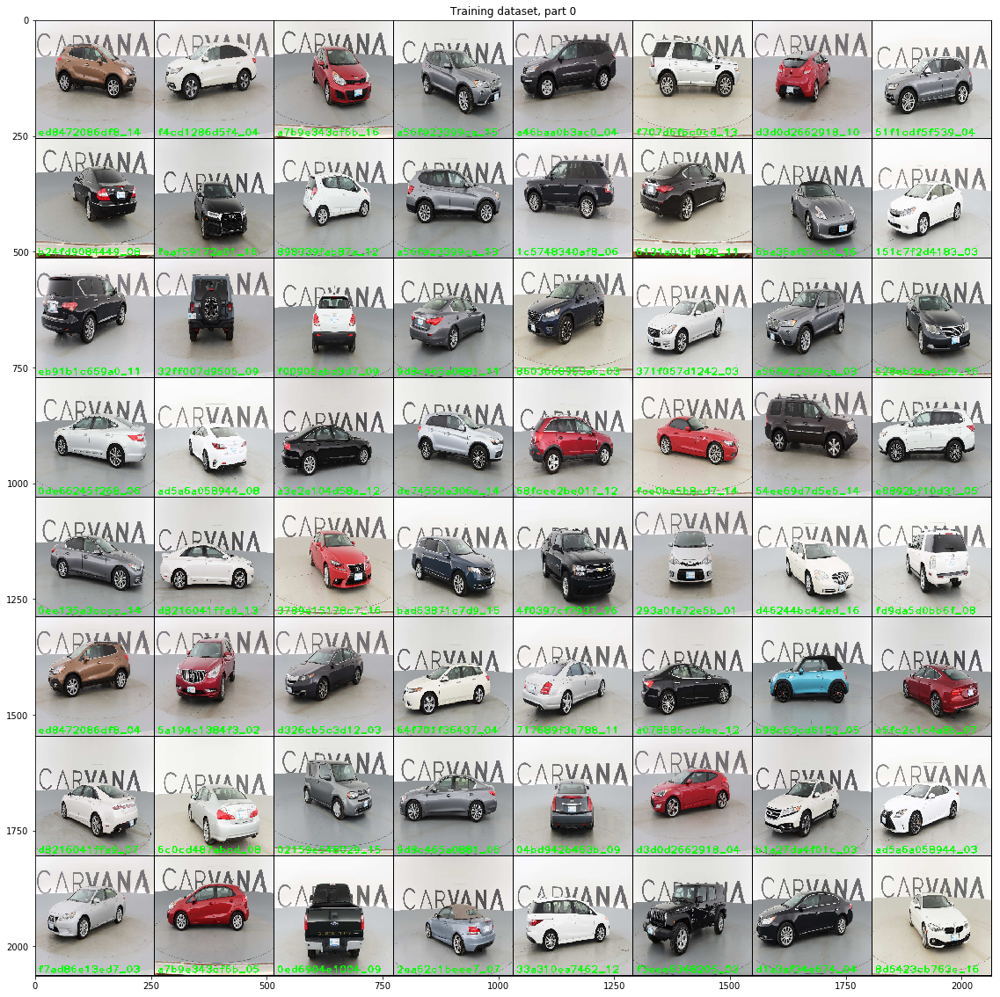

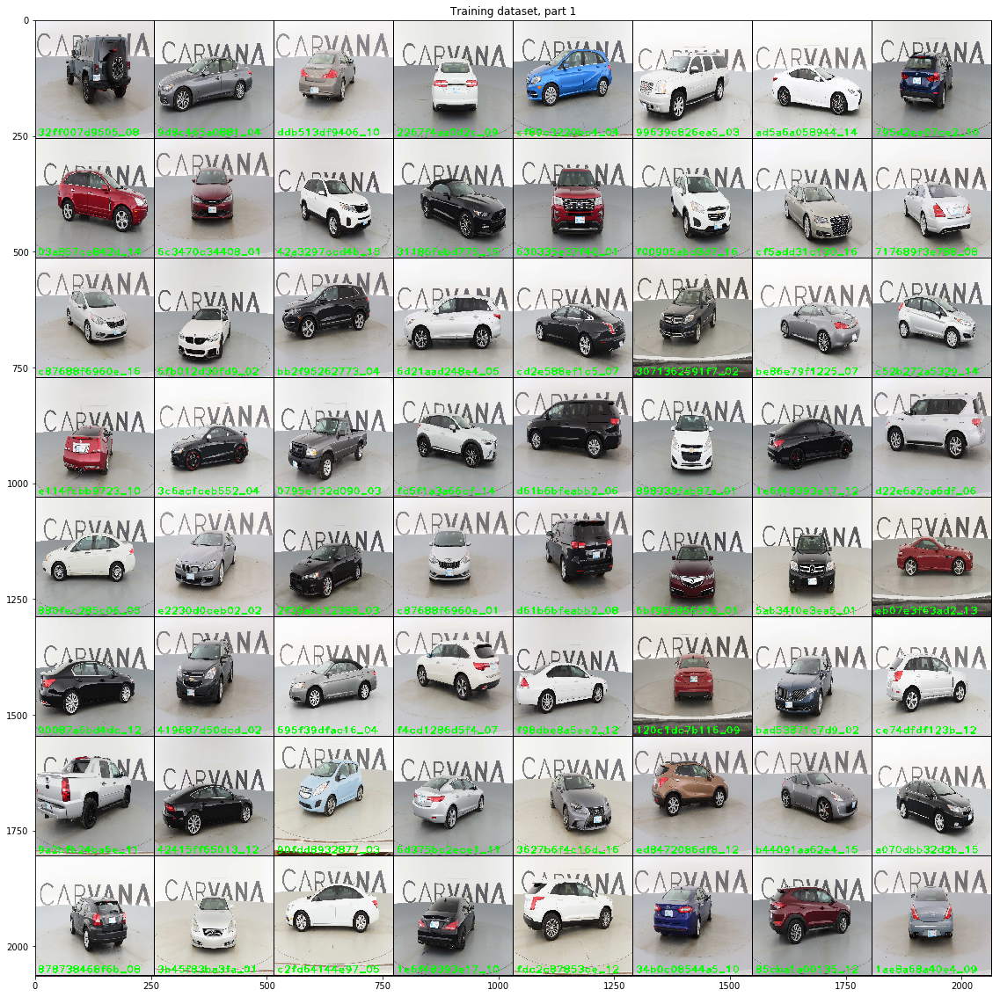

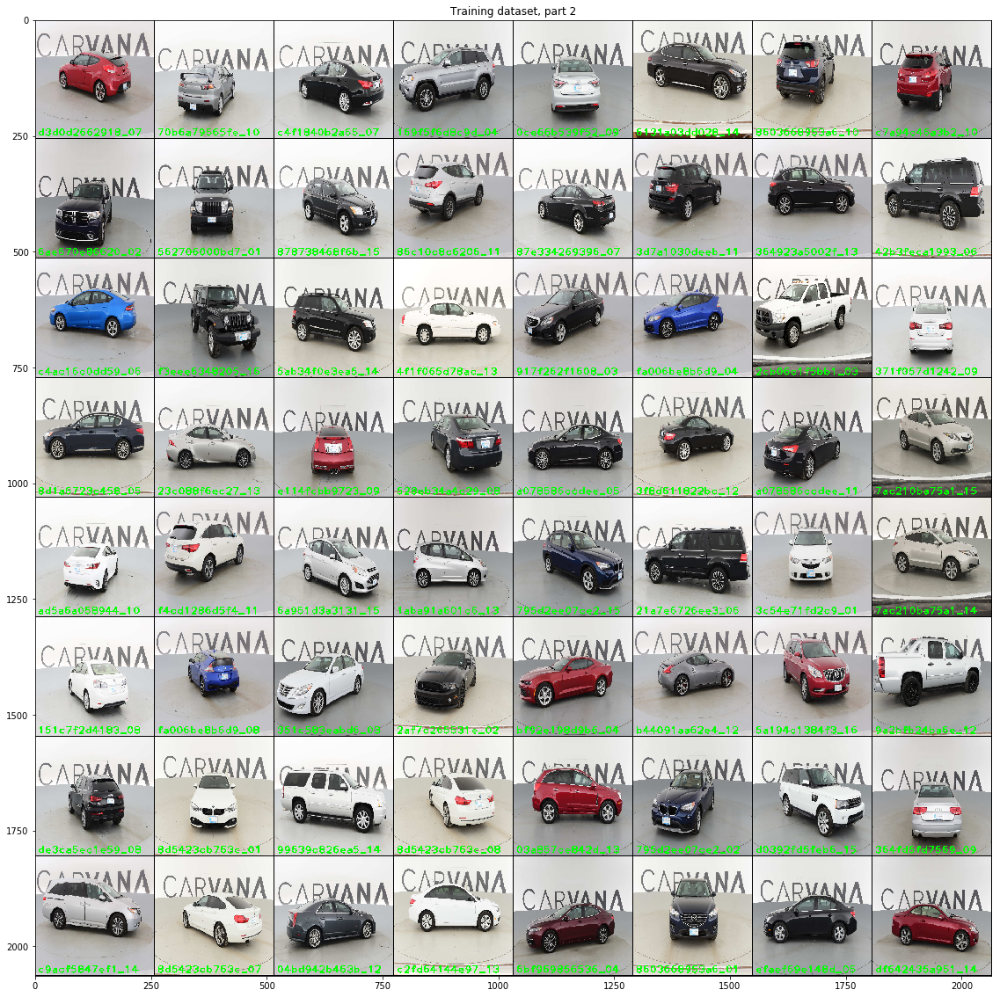

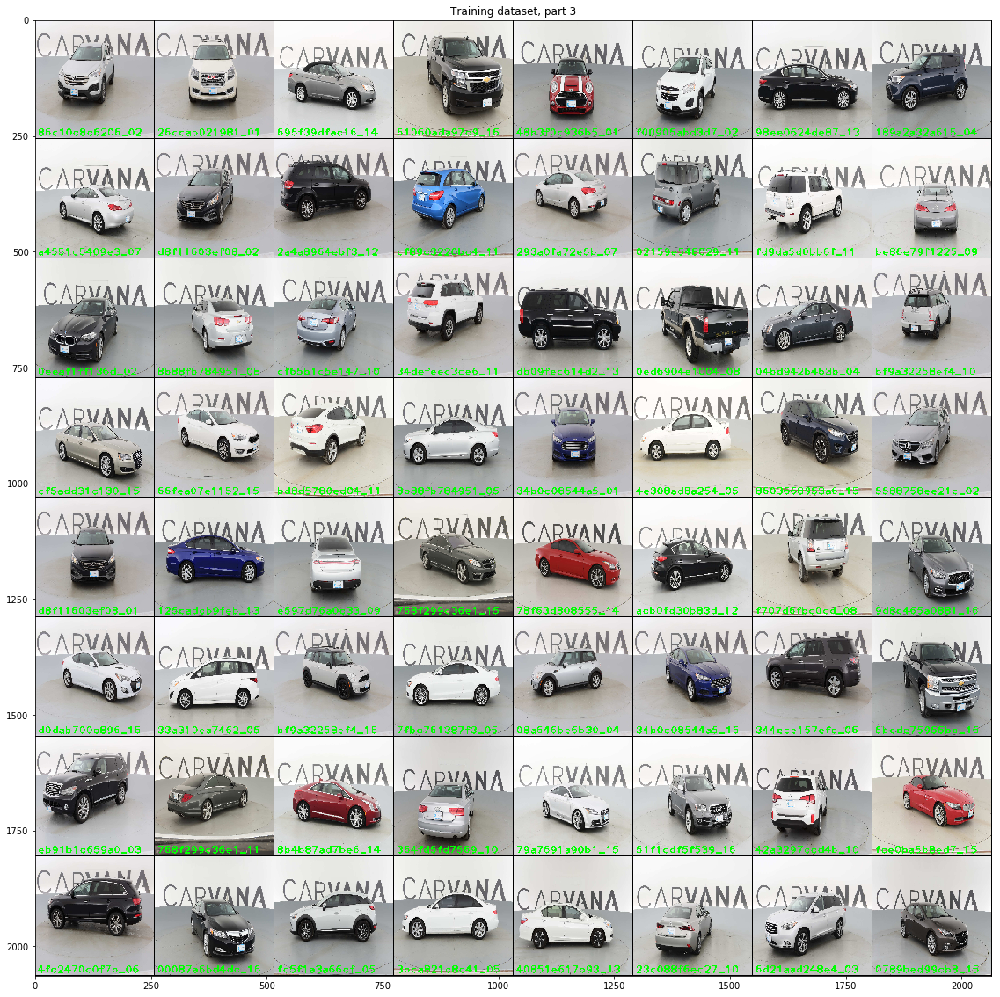

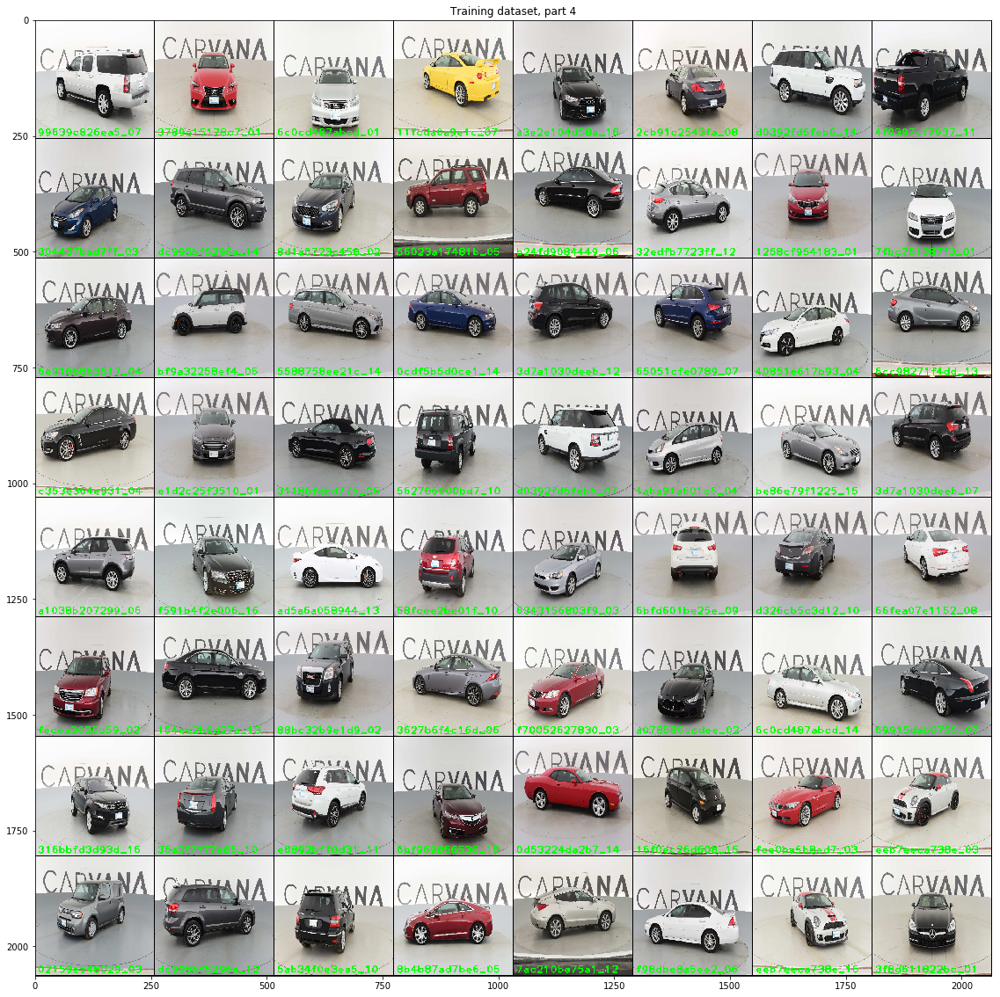

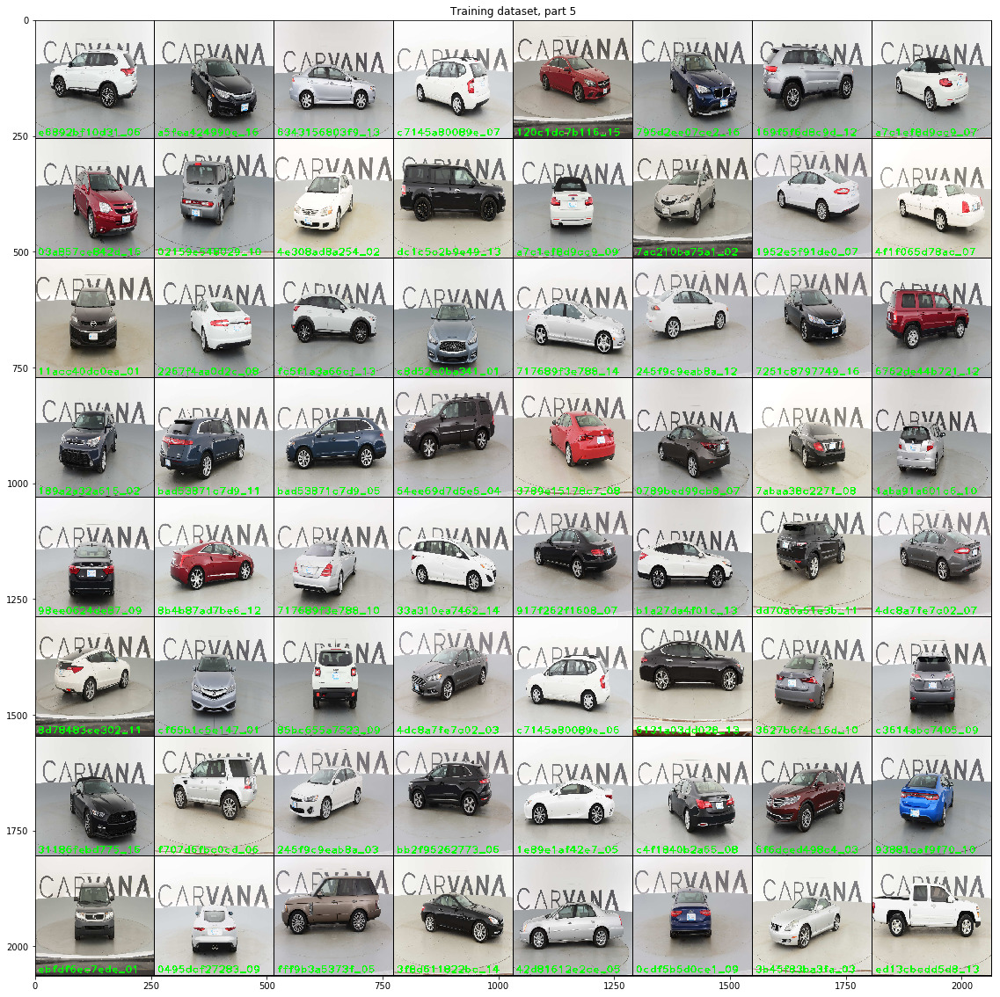

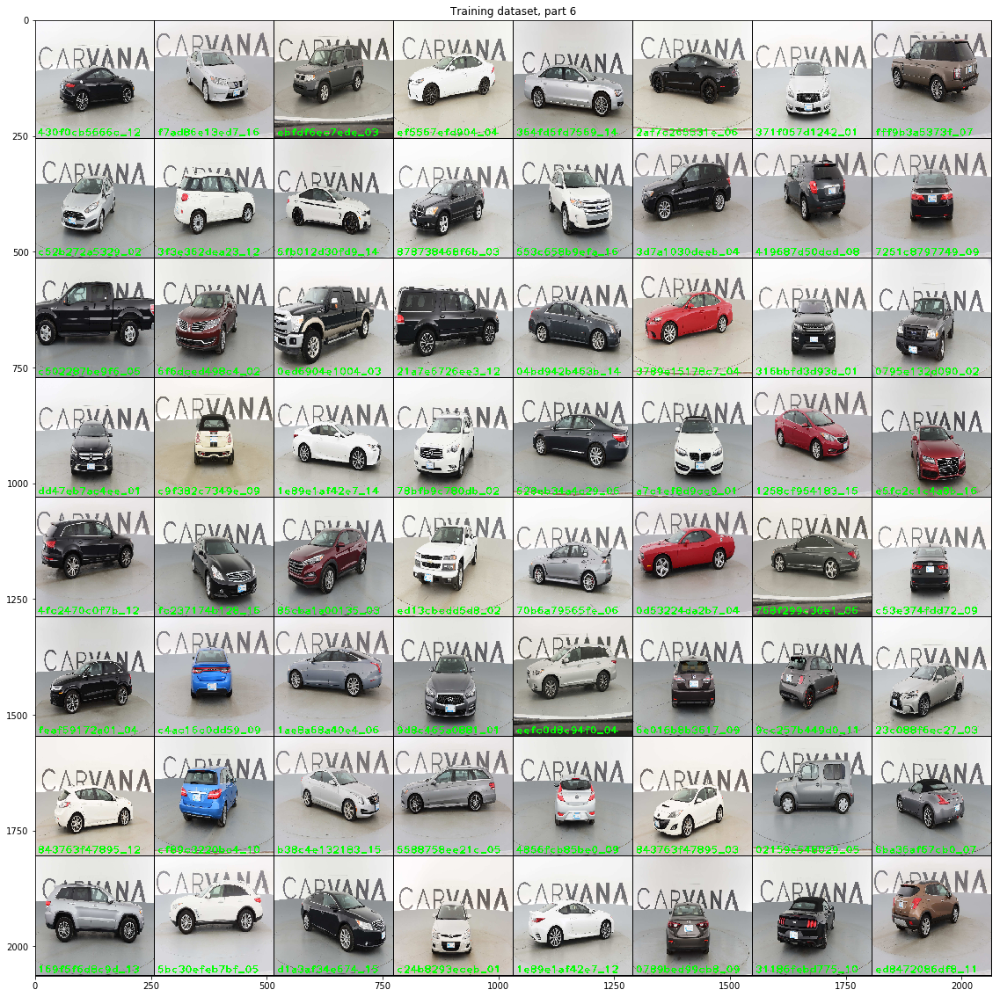

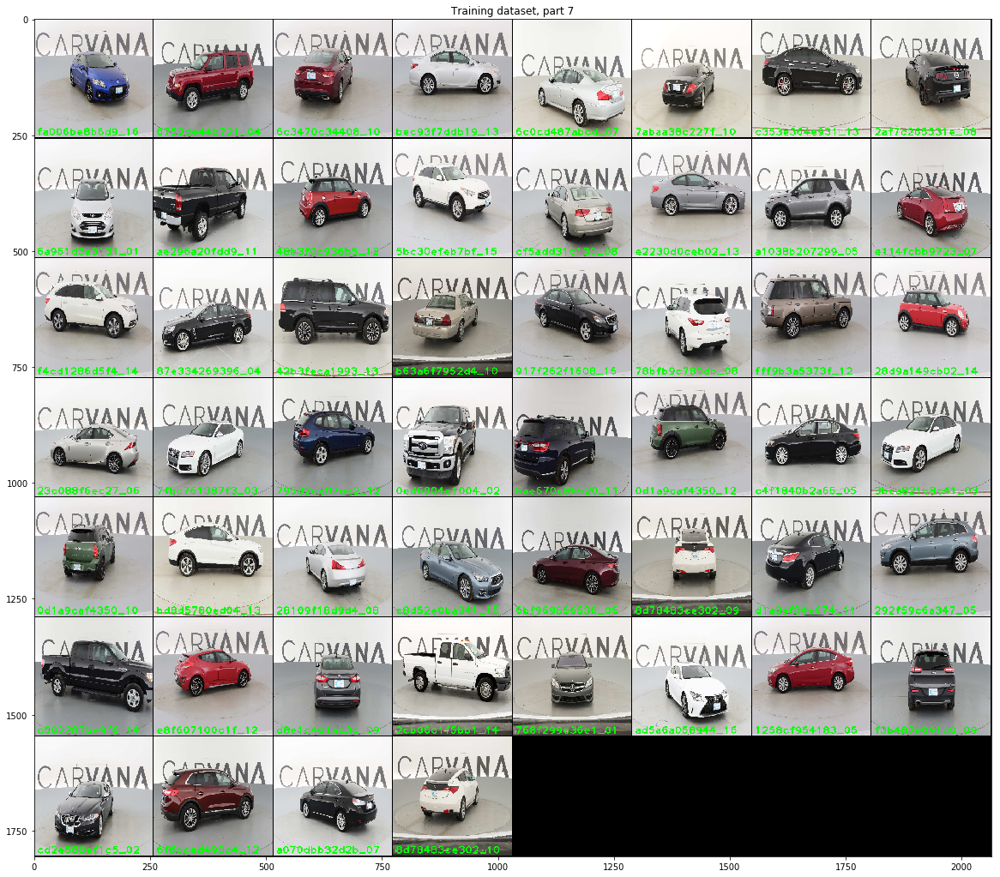

In [10]:
m = complete_image.shape[0] / (tile_size[0] + 2)
k = 8
n = int(np.ceil(m / k))
for i in range(n):
    plt.figure(figsize=(20, 20))
    ys = i*(tile_size[0] + 2)*k
    ye = min((i+1)*(tile_size[0] + 2)*k, complete_image.shape[0])
    plt.imshow(complete_image[ys:ye,:,:])
    plt.title("Training dataset, part %i" % i)

How many different cars in all datasets:

In [35]:
METADATA_CSV.head()

,id,year,make,model,trim1,trim2
0,0004d4463b50,2014.0,Acura,TL,TL,w/SE
1,00087a6bd4dc,2014.0,Acura,RLX,RLX,w/Tech
2,000aa097d423,2012.0,Mazda,MAZDA6,MAZDA6,i Sport
3,000f19f6e7d4,2016.0,Chevrolet,Camaro,Camaro,SS
4,00144e887ae9,2015.0,Acura,TLX,TLX,SH-AWD V6 w/Advance Pkg


In [36]:
len(METADATA_CSV['id'].unique()), len(METADATA_CSV['id'])

(6572, 6572)

How many different cars (ids) in train dataset:

In [9]:
len(TRAIN_MASKS_CSV['id'].unique()), len(TRAIN_MASKS_CSV['id'].unique()) * 16

(318, 5088)

In [8]:
all_318_car_ids = TRAIN_MASKS_CSV['id'].unique()

Display all 318 cars at '03' angle from train dataset

In [9]:
all_318_cars_image_ids = [_id + '_03' for _id in all_318_car_ids]

In [42]:
_train_ids = list(all_318_cars_image_ids)
tile_size = (256, 256)
n = 8

m = int(np.ceil(len(_train_ids) * 1.0 / n))
complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)

counter = 0
for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(_train_ids):
            break
        image_id = _train_ids[counter]; counter+=1
        img = get_image_data(image_id, 'Train')
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_PLAIN, 1.5, (0, 255, 0), thickness=2)
        complete_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(_train_ids):
        break    

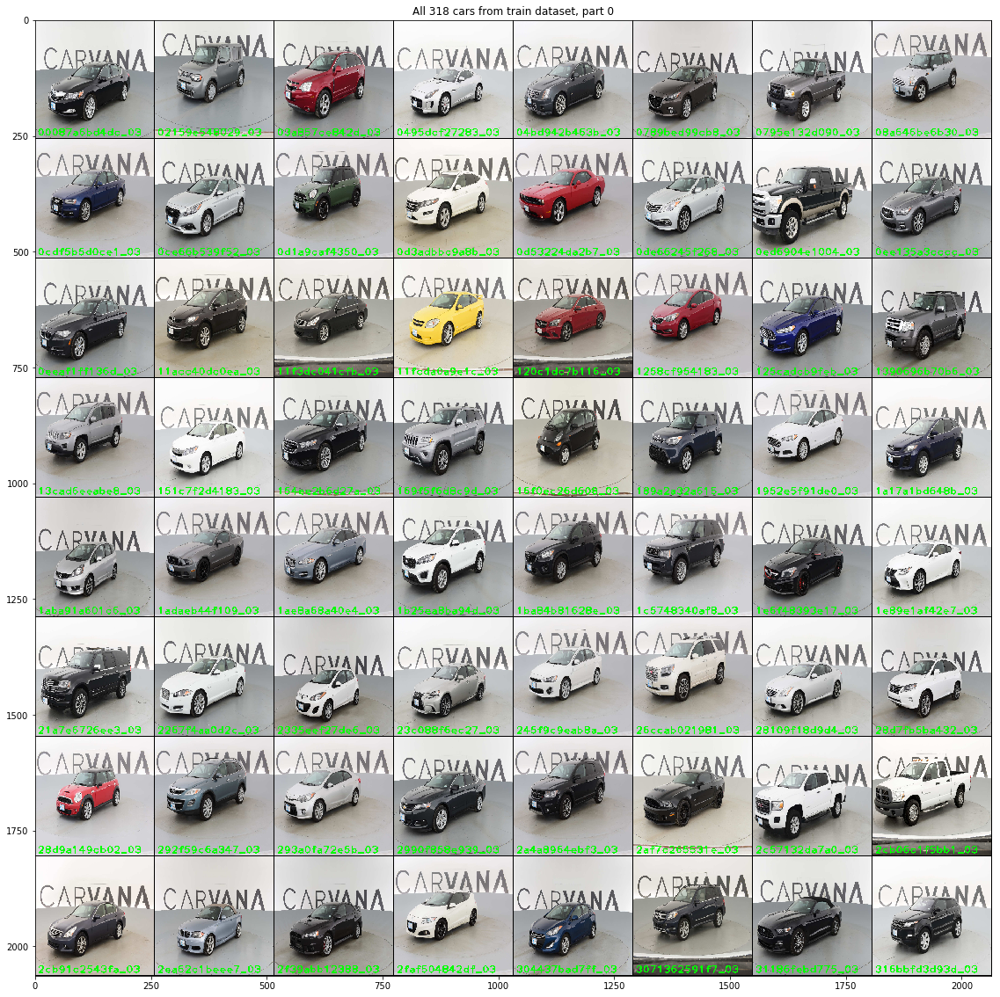

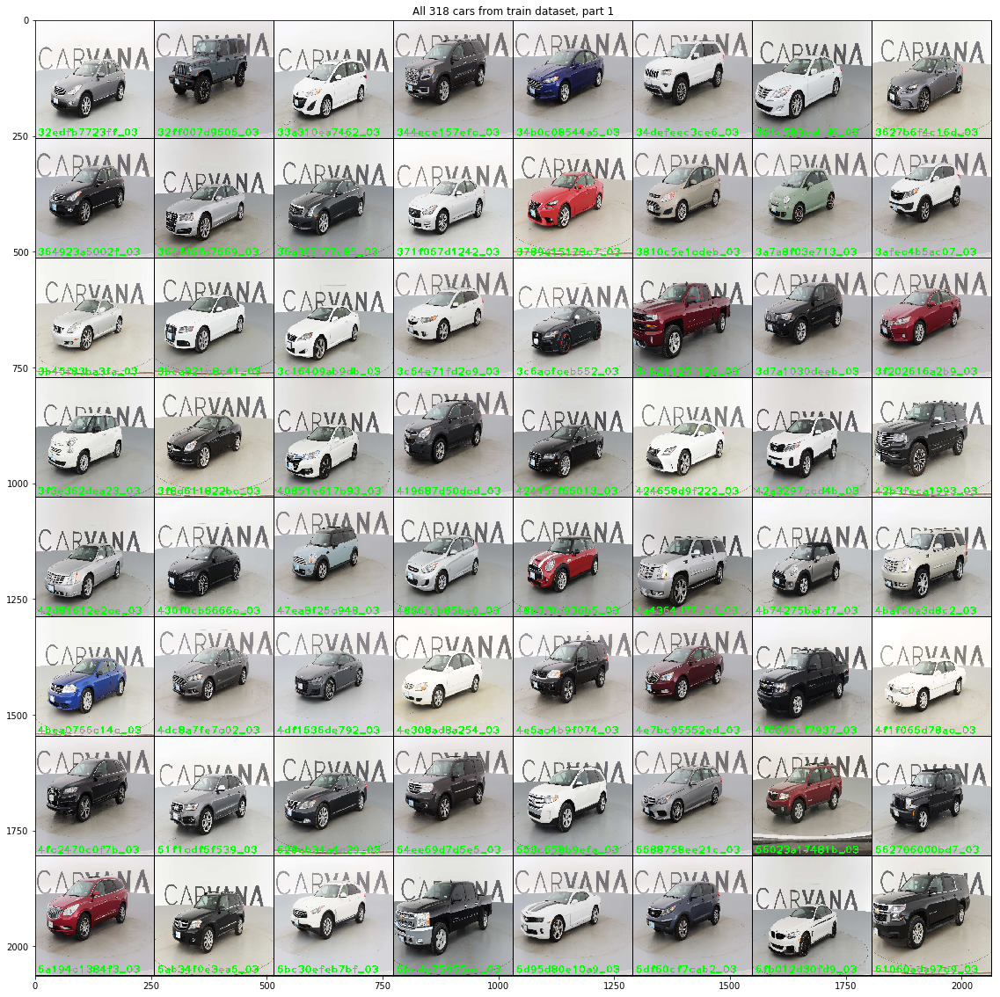

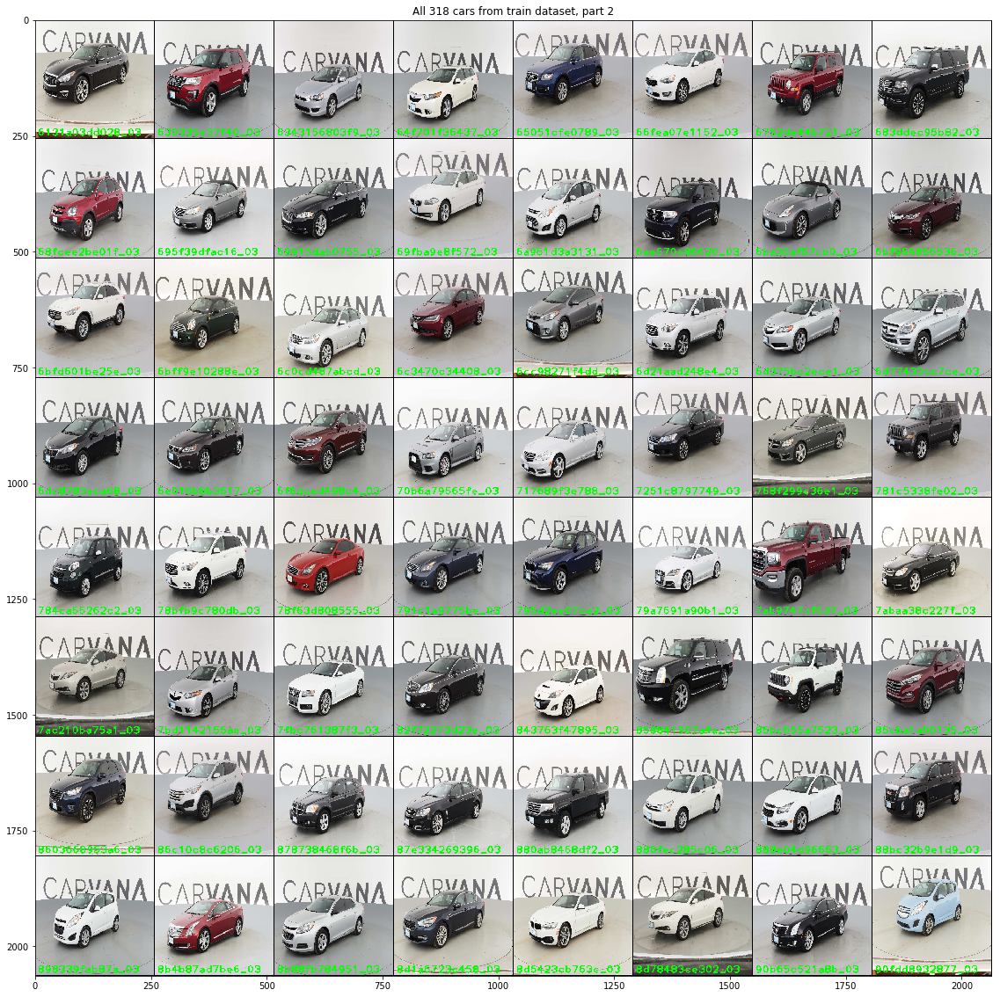

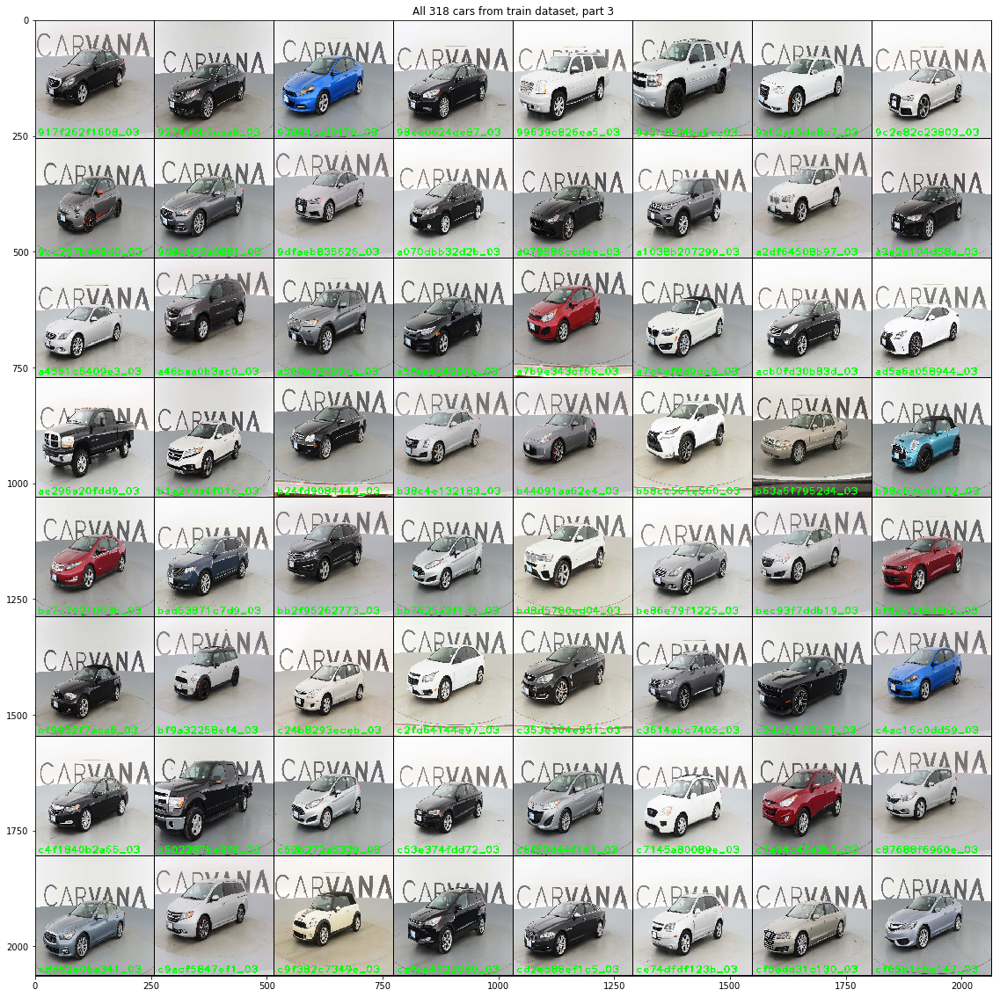

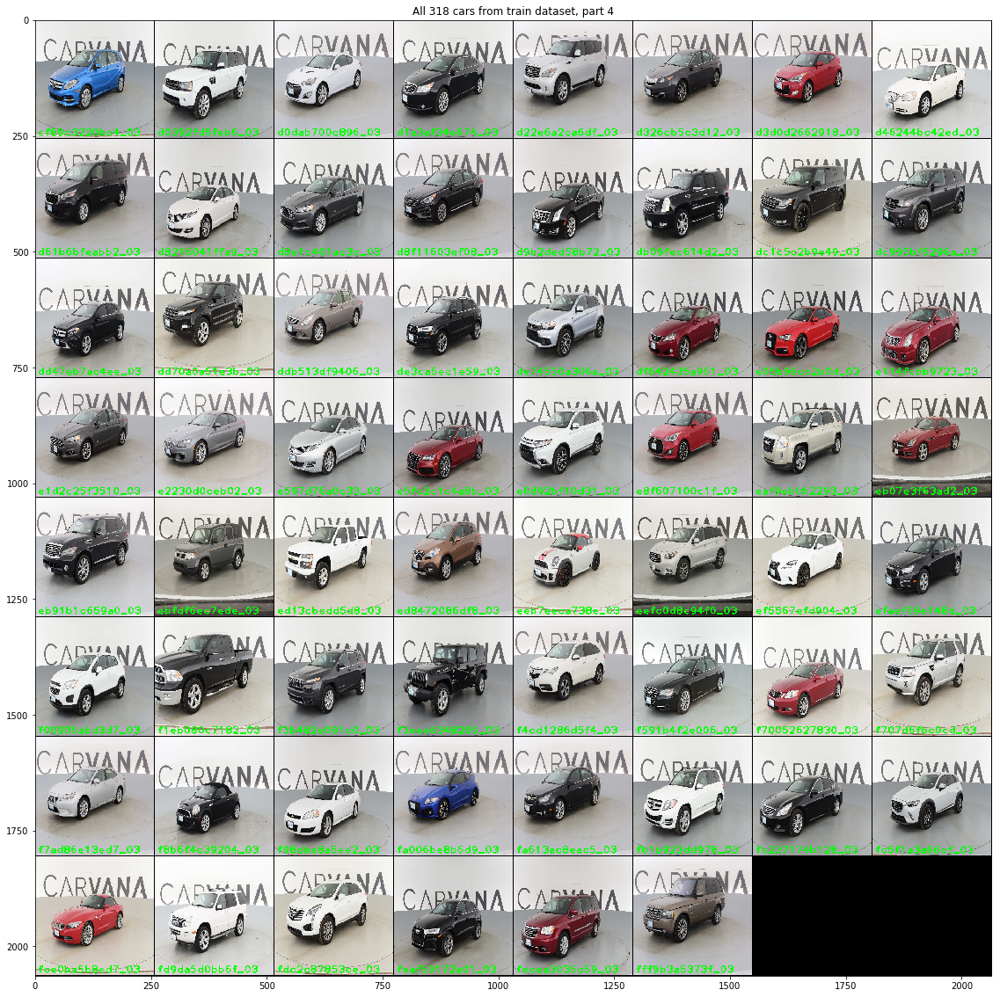

In [43]:
m = complete_image.shape[0] / (tile_size[0] + 2)
k = 8
n = int(np.ceil(m / k))
for i in range(n):
    plt.figure(figsize=(20, 20))
    ys = i*(tile_size[0] + 2)*k
    ye = min((i+1)*(tile_size[0] + 2)*k, complete_image.shape[0])
    plt.imshow(complete_image[ys:ye,:,:])
    plt.title("All 318 cars from train dataset, part %i" % i)

Which car makers are present in the train dataset:

In [10]:
_metadata_csv = METADATA_CSV.copy()
_metadata_csv.index = METADATA_CSV['id']

In [11]:
train_metadata_csv = _metadata_csv.loc[TRAIN_MASKS_CSV['id'].unique(),:]

In [13]:
import seaborn as sns

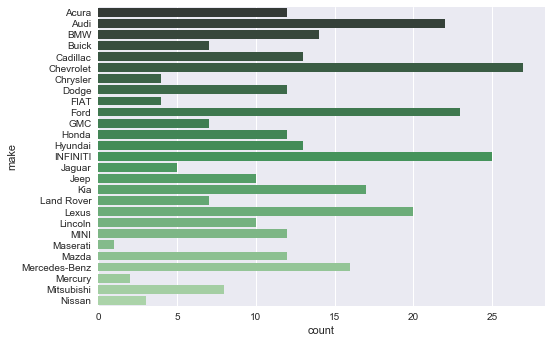

In [14]:
sns.countplot(y="make", data=train_metadata_csv.sort_values(by='make'), palette="Greens_d")

And how many different car identified by its year, maker, model and trim1

In [15]:
train_gb_year_make_model_trim1 = train_metadata_csv.groupby(['year', 'make', 'model', 'trim1'])
len(train_gb_year_make_model_trim1.groups)

308

How many groups of similar cars varying by trim2

In [43]:
similar_cars = [k for k in train_gb_year_make_model_trim1.groups if len(train_gb_year_make_model_trim1.groups[k]) > 1]
len(similar_cars)

10

Display similar cars

In [44]:
sns.set_style("whitegrid", {'axes.grid' : False})

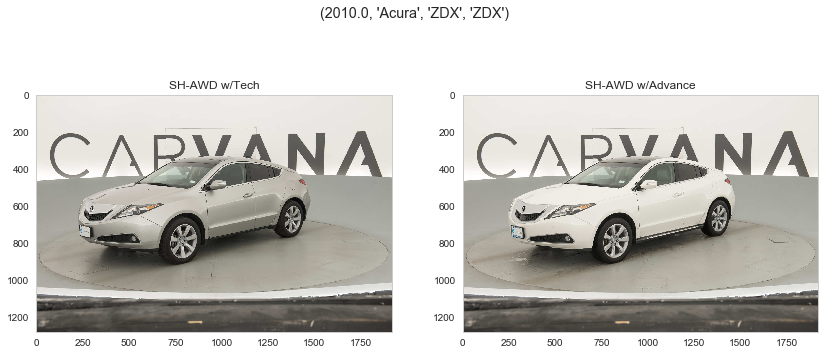

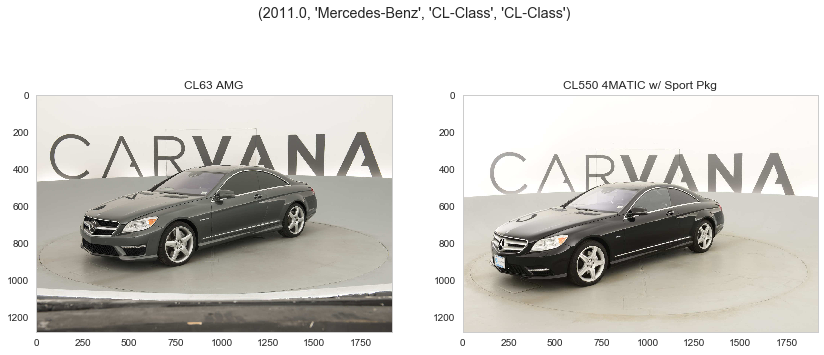

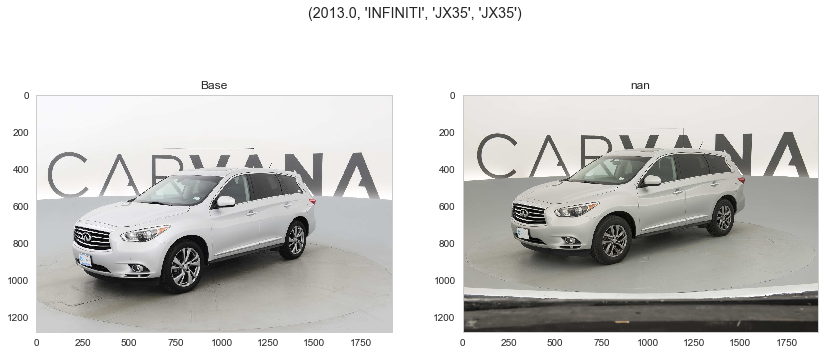

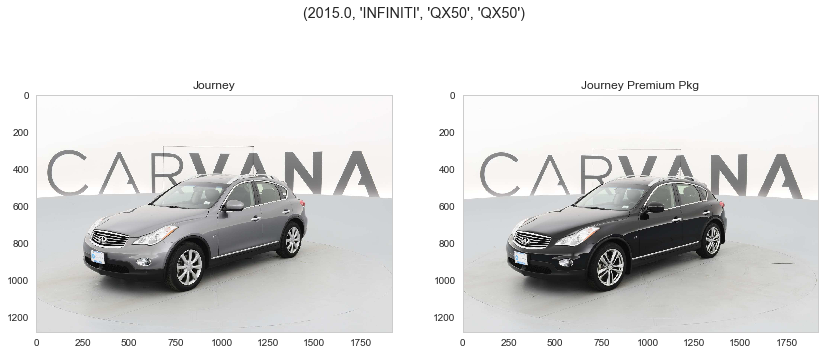

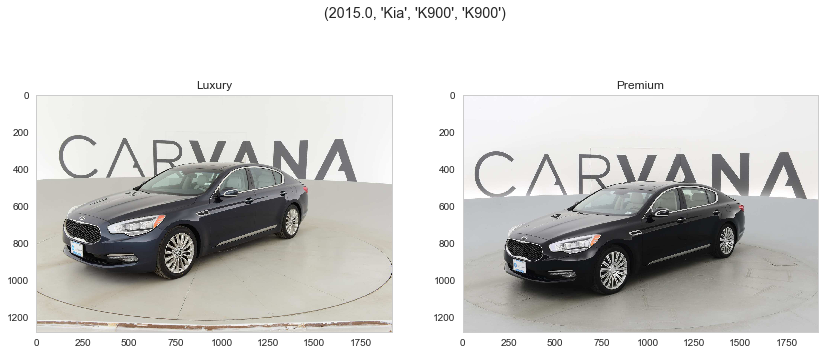

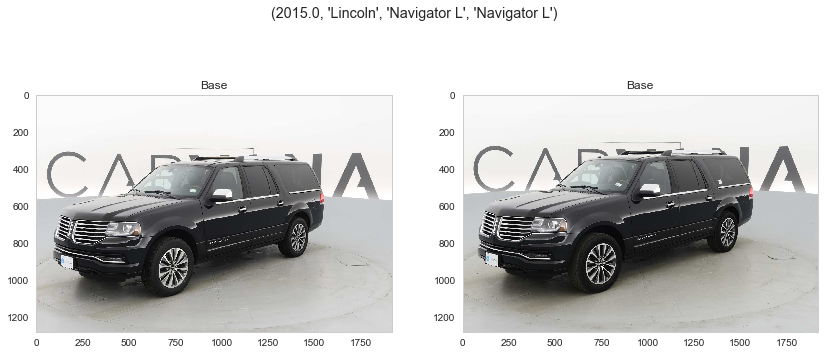

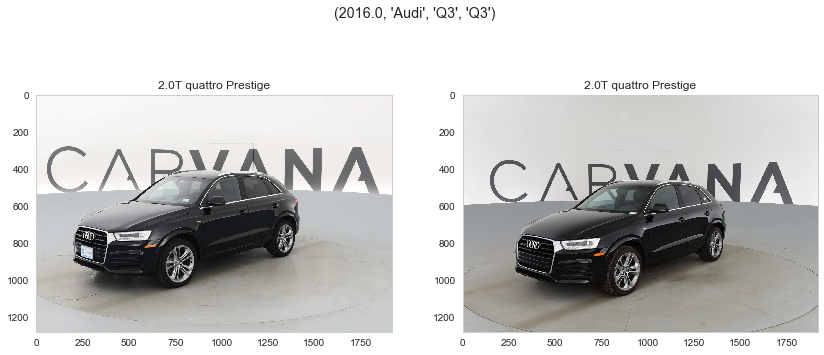

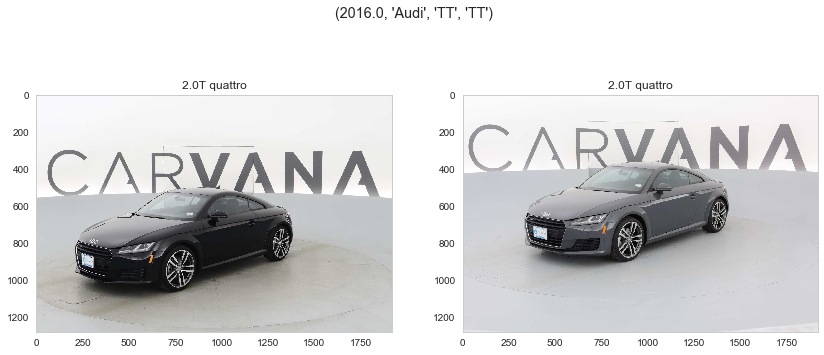

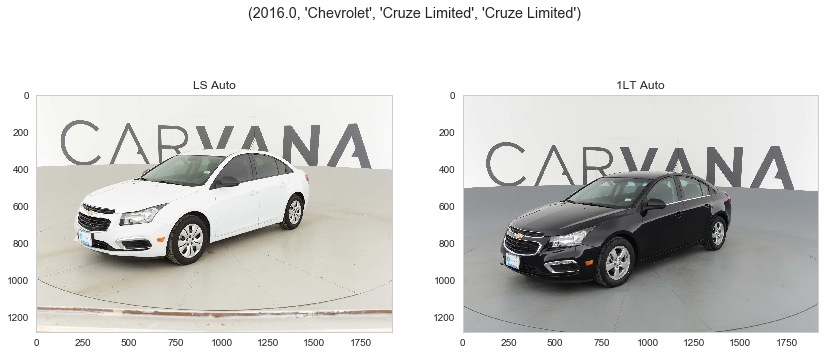

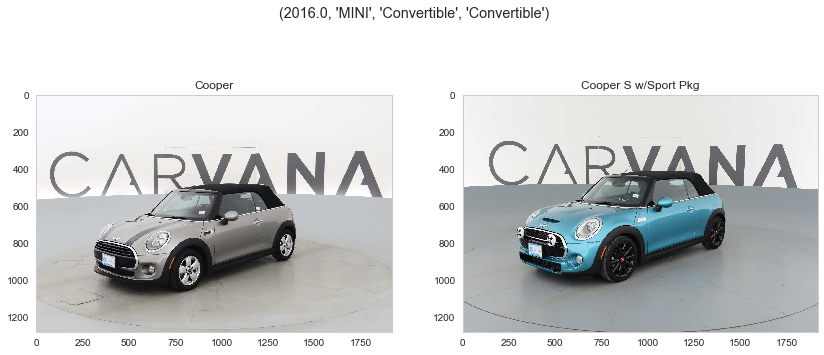

In [45]:
for gname in similar_cars:
    _ids = train_gb_year_make_model_trim1.get_group(gname)['id']
    _trim2 = train_gb_year_make_model_trim1.get_group(gname)['trim2']
    plt.figure(figsize=(14, 6))
    plt.suptitle("{}".format(gname))    
    n = len(_ids)
    for i, _id in enumerate(_ids):
        plt.subplot(1, n, i + 1)
        plt.title('{}'.format(_trim2[i]))
        img = get_image_data(_id + '_03', 'Train')
        plt.imshow(img)        
    

Which cars are present in the test dataset:

In [17]:
test_dataset_ids = list(set(METADATA_CSV['id']) - set(TRAIN_MASKS_CSV['id']))
len(test_dataset_ids), len(METADATA_CSV['id'])

(6254, 6572)

In [18]:
test_metadata_csv = _metadata_csv.loc[test_dataset_ids,:]

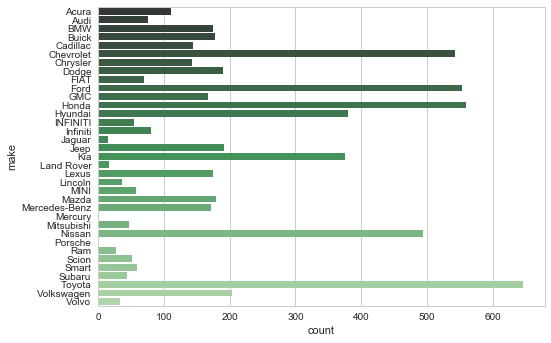

In [20]:
sns.countplot(y="make", data=test_metadata_csv.sort_values(by='make'), palette="Greens_d")

How many new makers present in test dataset

In [24]:
set(test_metadata_csv['make'].unique()) - set(train_metadata_csv['make'].unique())

{nan,
 'Smart',
 'Ram',
 'Porsche',
 'Scion',
 'Toyota',
 'Infiniti',
 'Volvo',
 'Volkswagen',
 'Subaru'}

In [25]:
test_metadata_csv.loc[test_metadata_csv['trim1'].isnull(), 'trim1'] = '-'

And how many different car identified by its year, maker, model and trim1

In [26]:
test_gb_year_make_model_trim1 = test_metadata_csv.groupby(['year', 'make', 'model', 'trim1'])
len(test_gb_year_make_model_trim1.groups)

1083

How many groups of similar cars varying by trim2

In [27]:
similar_cars = [k for k in test_gb_year_make_model_trim1.groups if len(test_gb_year_make_model_trim1.groups[k]) > 1]
len(similar_cars)

685

Display some of similar cars

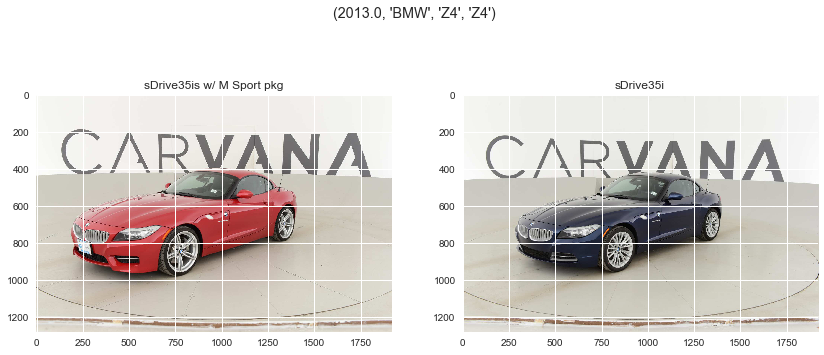

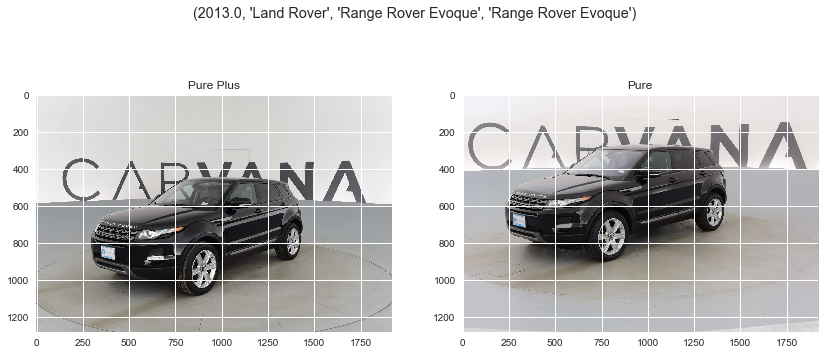

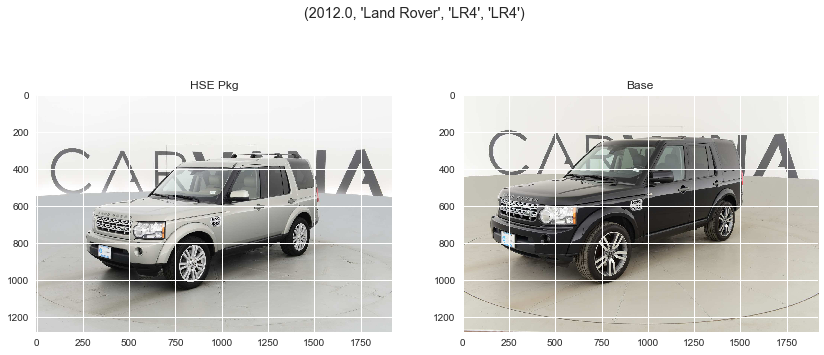

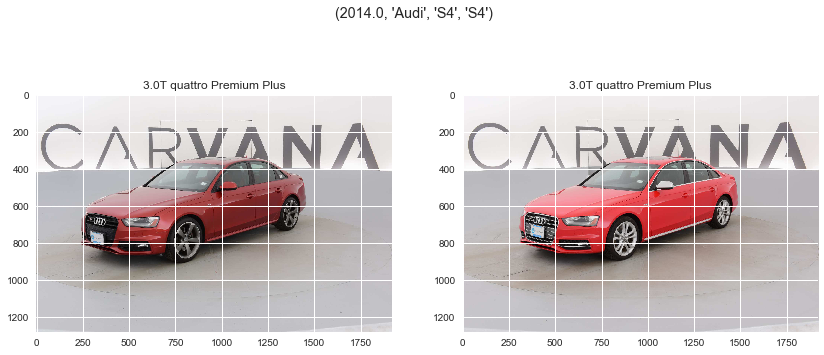

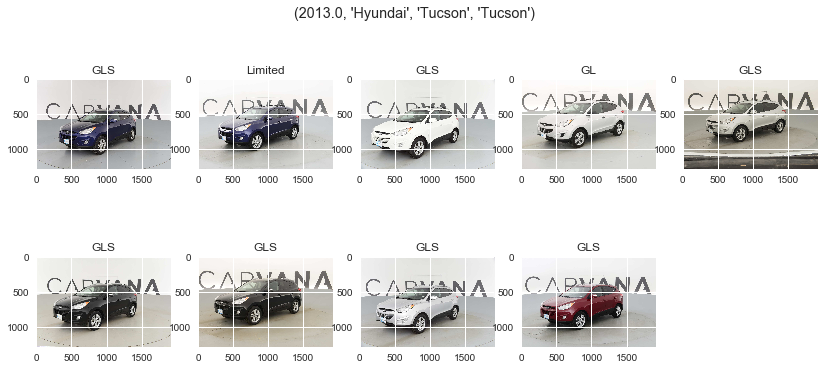

...

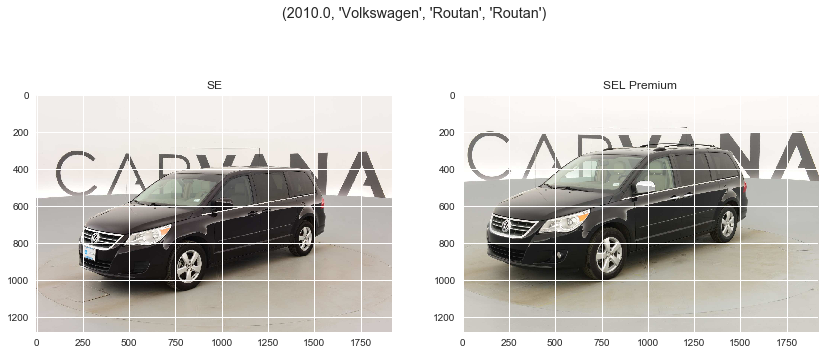

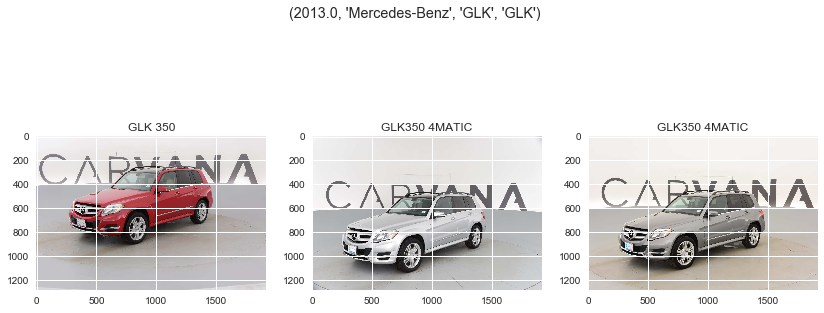

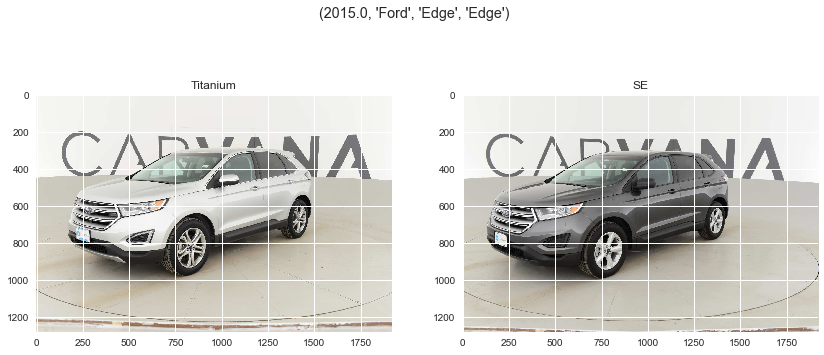

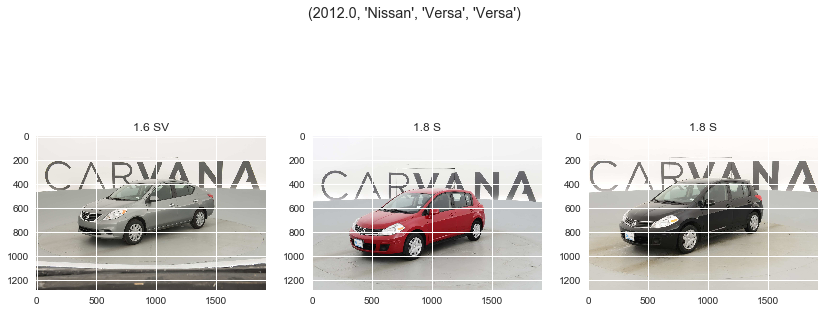

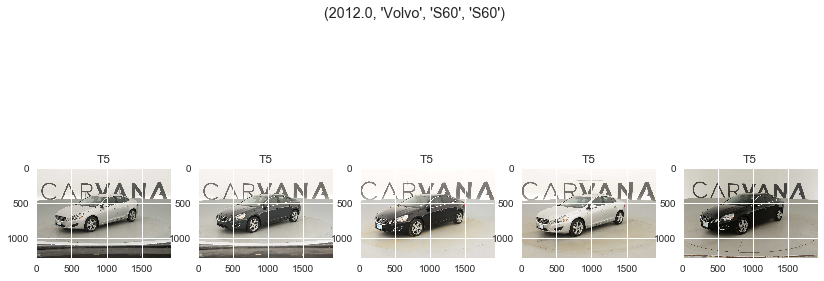

In [152]:
k = 5 
for gname in similar_cars[:20]:
    _ids = test_gb_year_make_model_trim1.get_group(gname)['id']      
    _trim2 = test_gb_year_make_model_trim1.get_group(gname)['trim2']    
    plt.figure(figsize=(14, 6))
    plt.suptitle("{}".format(gname))    
    n = min(len(_ids), k)
    m = int(np.ceil(len(_ids) * 1.0 / k))
    for i, _id in enumerate(_ids):
        plt.subplot(m, n, i + 1)    
        plt.title("{}".format(_trim2[i]))
        img = get_image_data(_id + '_03', 'Test')
        plt.imshow(img)        
    

### Same car models in train and test ?

In [90]:
_metadata_csv['in_train'] = False
_metadata_csv['in_test'] = False

_metadata_csv.loc[test_dataset_ids, 'in_test'] = True
_metadata_csv.loc[TRAIN_MASKS_CSV['id'].unique(), 'in_train'] = True

In [91]:
_metadata_csv[_metadata_csv['in_train'] & _metadata_csv['in_test']]

,id,year,make,model,trim1,trim2,in_train,in_test
id,,,,,,,,


In [153]:
_metadata_csv.loc[_metadata_csv['trim1'].isnull(), 'trim1'] = '-'

In [155]:
gb_year_make_model_trim1 = _metadata_csv.groupby(['year', 'make', 'model', 'trim1'])
len(gb_year_make_model_trim1.groups)

1212

In [156]:
similar_cars = [k for k in gb_year_make_model_trim1.groups if len(gb_year_make_model_trim1.groups[k]) > 1]
len(similar_cars)

760

In [161]:
gb_year_make_model_trim1.get_group(similar_cars[0])

,id,year,make,model,trim1,trim2,in_train,in_test
id,,,,,,,,
0e1a091d1b8a,0e1a091d1b8a,2013.0,BMW,Z4,Z4,sDrive35i,False,True
979e789a45f7,979e789a45f7,2013.0,BMW,Z4,Z4,sDrive35is w/ M Sport pkg,False,True
fce0ba5b8ed7,fce0ba5b8ed7,2013.0,BMW,Z4,Z4,sDrive35i,True,False


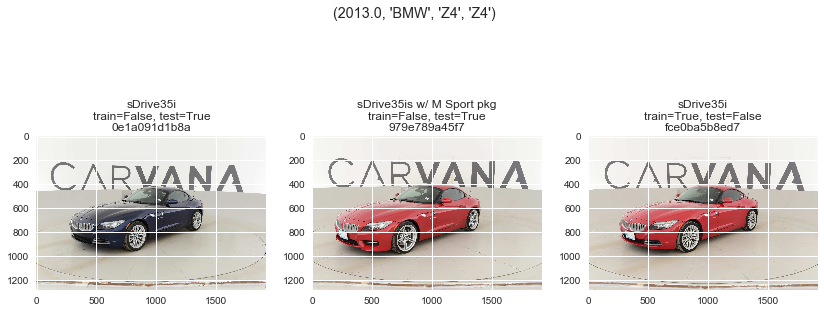

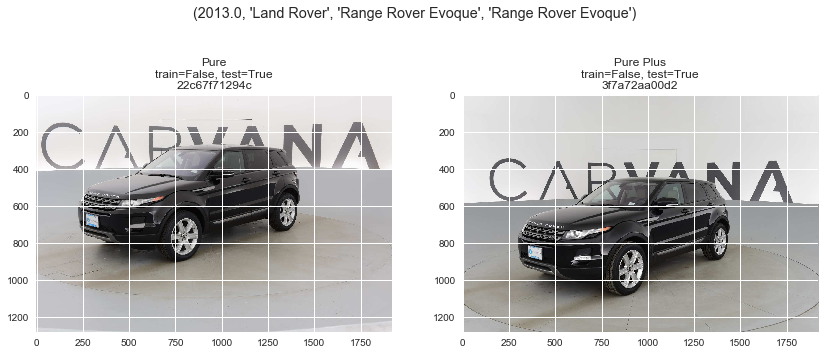

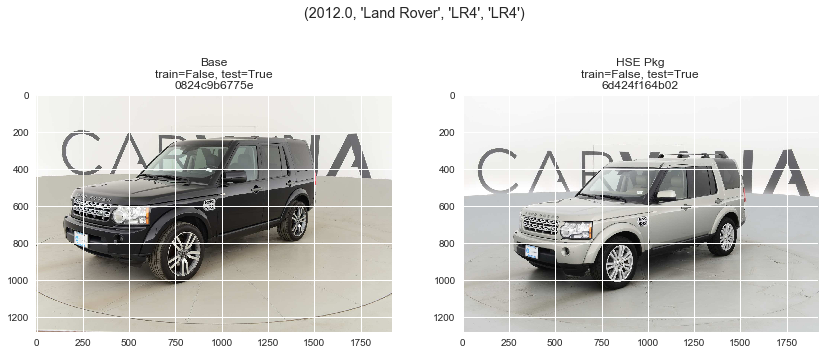

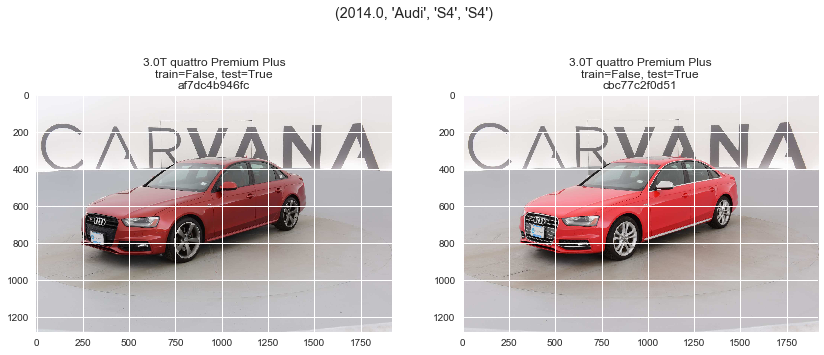

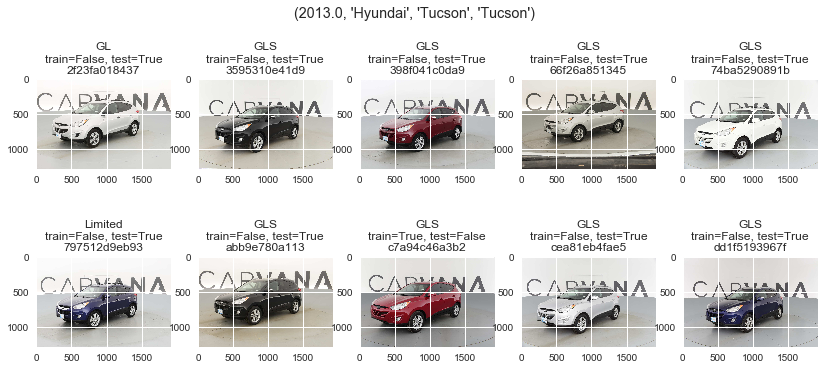

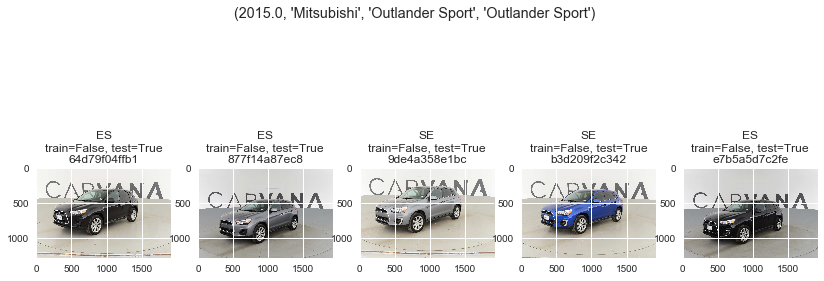

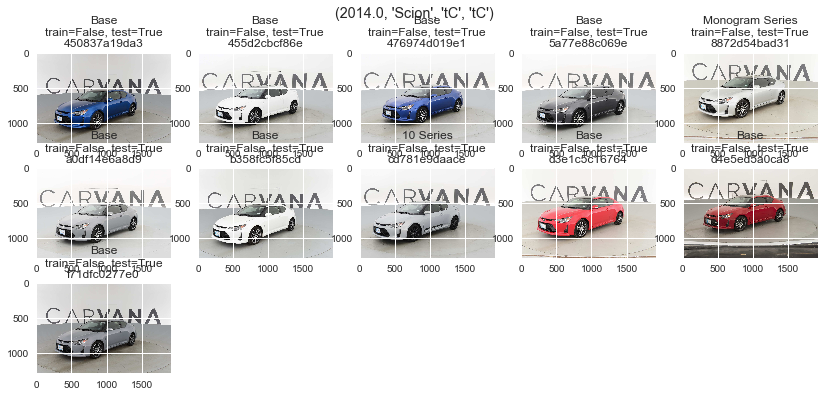

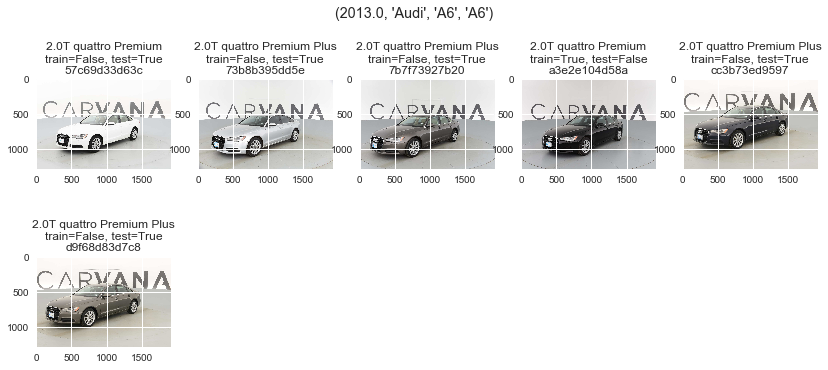

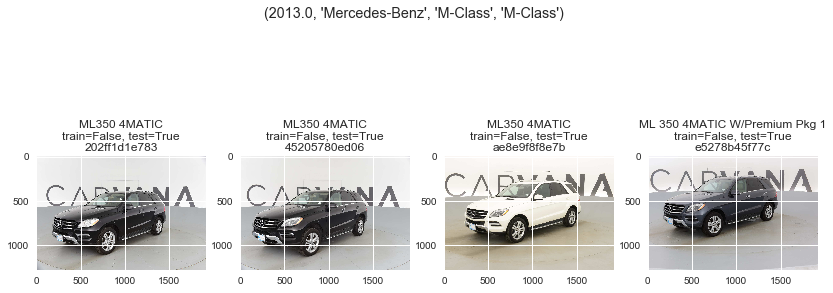

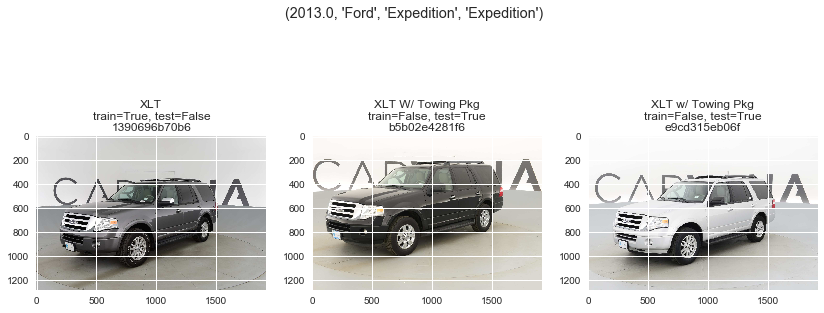

In [162]:
k = 5 
for gname in similar_cars[:10]:
    _ids = gb_year_make_model_trim1.get_group(gname)['id']      
    _trim2 = gb_year_make_model_trim1.get_group(gname)['trim2']
    _in_train = gb_year_make_model_trim1.get_group(gname)['in_train']
    _in_test = gb_year_make_model_trim1.get_group(gname)['in_test']    
    
    plt.figure(figsize=(14, 6))
    plt.suptitle("{}".format(gname))    
    n = min(len(_ids), k)
    m = int(np.ceil(len(_ids) * 1.0 / k))
    for i, _id in enumerate(_ids):
        plt.subplot(m, n, i + 1)    
        plt.title("{}\ntrain={}, test={}\n{}".format(_trim2[i], _in_train[i], _in_test[i], _id))
        image_type = "Train" if  _in_train[i] else "Test"
        img = get_image_data(_id + '_03', image_type)
        plt.imshow(img)        
    

In [181]:
cond = lambda k: (len(gb_year_make_model_trim1.groups[k]) > 1) and gb_year_make_model_trim1.get_group(k)[['in_train', 'in_test']].any().all()
models_in_train_and_test = [k for k in gb_year_make_model_trim1.groups if cond(k)]
len(models_in_train_and_test)

179

In [187]:
sns.set_style("whitegrid", {'axes.grid' : False})

In [193]:
import cv2

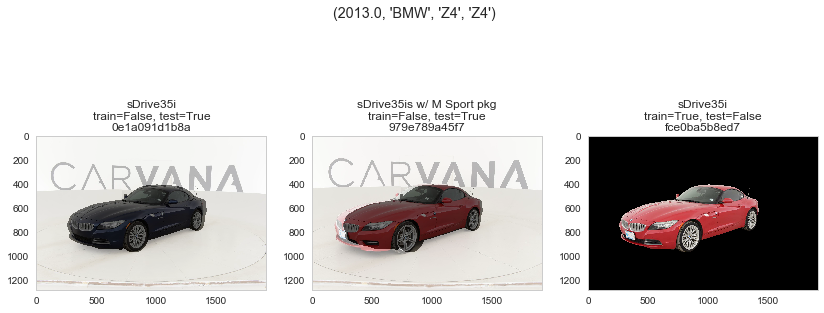

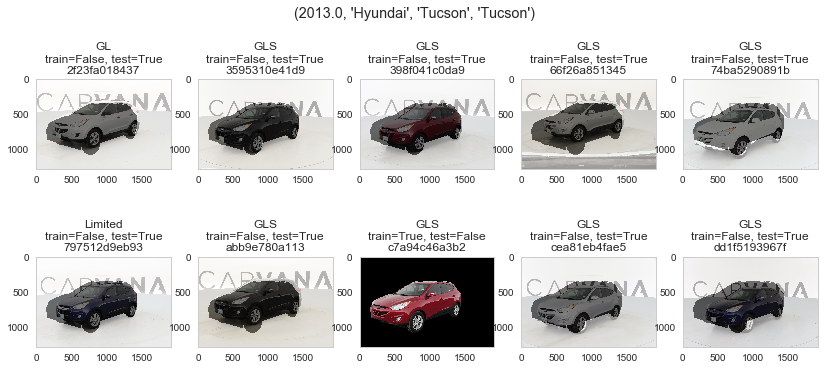

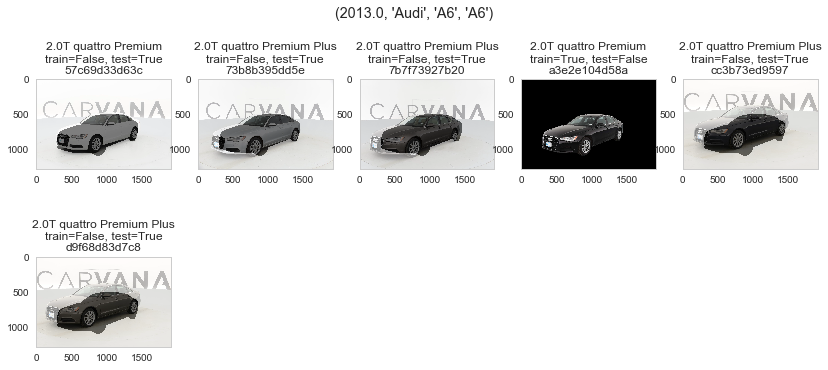

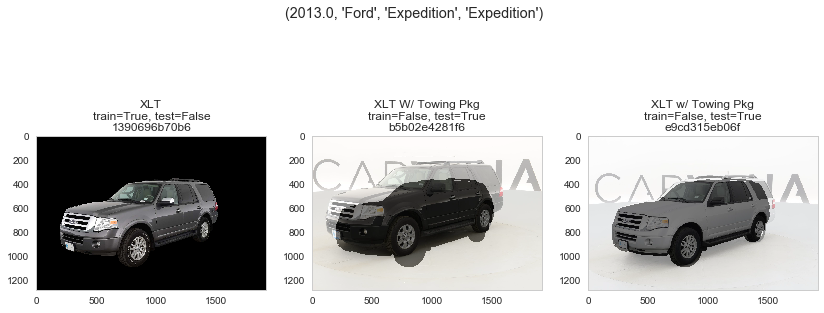

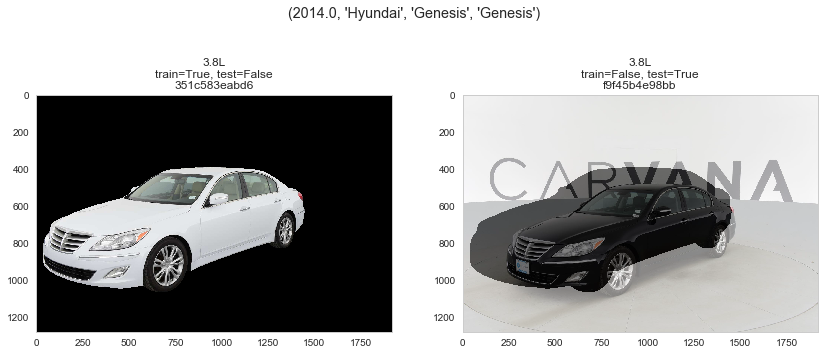

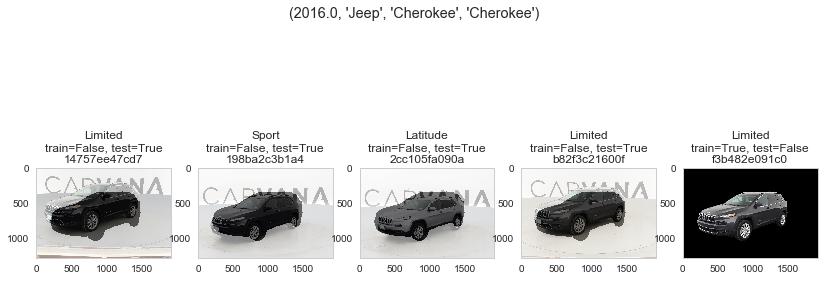

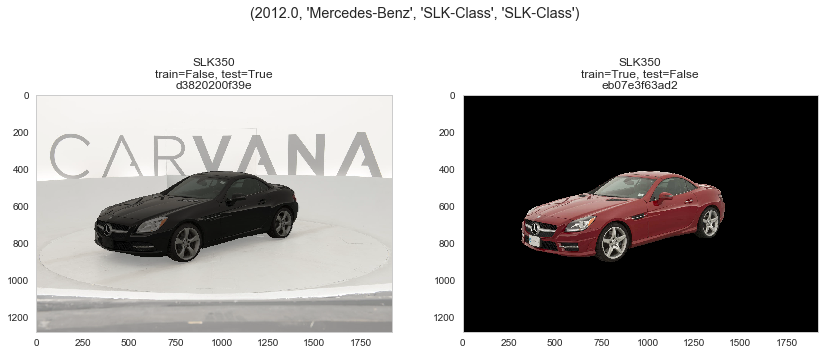

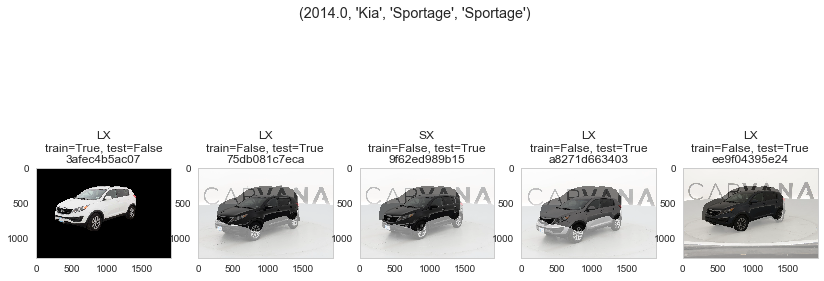

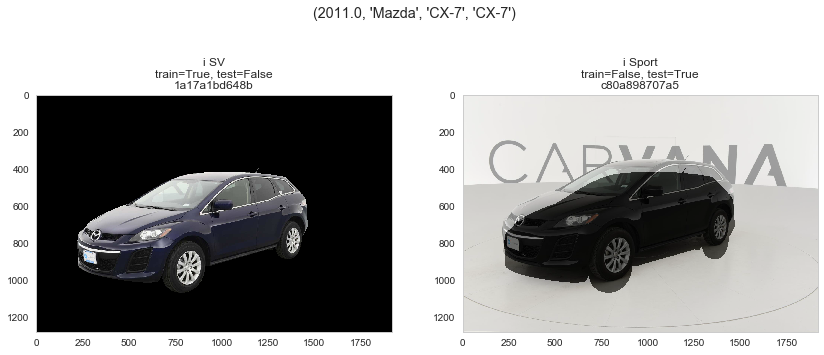

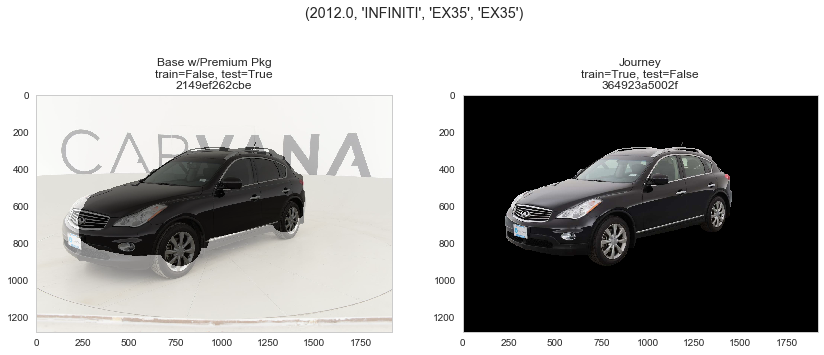

In [197]:
k = 5 
for gname in models_in_train_and_test[:10]:
    _ids = gb_year_make_model_trim1.get_group(gname)['id']      
    _trim2 = gb_year_make_model_trim1.get_group(gname)['trim2']
    _in_train = gb_year_make_model_trim1.get_group(gname)['in_train']
    _in_test = gb_year_make_model_trim1.get_group(gname)['in_test']    
    
    train_index = np.where(_in_train == True)[0][0]    
    first_train_mask = get_image_data(_ids[train_index] + '_03', "Train_mask")    
    
    plt.figure(figsize=(14, 6))
    plt.suptitle("{}".format(gname))    
    n = min(len(_ids), k)
    m = int(np.ceil(len(_ids) * 1.0 / k))
    for i, _id in enumerate(_ids):
        plt.subplot(m, n, i + 1)    
        plt.title("{}\ntrain={}, test={}\n{}".format(_trim2[i], _in_train[i], _in_test[i], _id))
        image_type = "Train" if  _in_train[i] else "Test"
        img = get_image_data(_id + '_03', image_type)
        if _in_train[i]:
            img = cv2.bitwise_and(img, img, mask=first_train_mask)
            plt.imshow(img)
        else:
            plt.imshow(img)
            plt.imshow(first_train_mask, alpha=0.50)

    